<a href="https://colab.research.google.com/github/JohnnyWang1998/Conversion_rate_prediction/blob/main/EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [5]:
import numpy as np
import pandas as pd
import seaborn as sn
from typing import List
from matplotlib import pyplot as plt
import plotly.express as px

In [6]:
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

In [7]:
from google.colab import drive
drive.mount('/content/drive')
data = pd.read_csv('/content/drive/MyDrive/train.csv')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# EDA

## Basic info

In [8]:
data.head()

,accepts_mercadopago,available_quantity,avg_gmv_item_domain_30days,avg_gmv_item_sel,avg_gmv_seller_bday,avg_qty_orders_item_domain_30days,avg_qty_orders_item_sel_30days,avg_si_item_sel_30day,benefit,boosted,category_id,conversion,date,deal_print_id,domain_id,etl_version,free_shipping,fulfillment,full_name,health,is_pdp,product_id,item_id,listing_type_id,logistic_type,main_picture,offset,original_price,platform,price,print_position,print_server_timestamp,qty_items_dom,qty_items_sel,site_id,sold_quantity,tags,title,total_asp_item_domain_30days,total_asp_item_sel_30days,total_gmv_domain_bday,total_gmv_item_30days,total_items_domain,total_items_seller,total_orders_domain_30days,total_orders_item_30days,total_orders_sel_30days,total_si_domain_30days,total_si_item_30days,total_si_sel_30days,total_visits_domain,total_visits_item,total_visits_seller,uid,user_id,warranty
0,True,59,938.031376,2153.933091,135195.200333,3.430563,12.407860,13.691450,0.001,False,MLA1055,False,2020-03-06,a9cb2270-5f61-11ea-89fc-13e674cbfad4,MLA-CELLPHONES,0.0.1,True,False,Celulares y Teléfonos -> Celulares y Smartphones,0.00,False,15183595.0,MLA830939055,gold_special,cross_docking,NaN,0,29999,/web/desktop,20999,1717,2020-03-06T00:19:30.735-0400,16000.0,1883.0,MLA,65,"[good_quality_picture, good_quality_thumbnail,...",Motorola One Action 128 Gb Denim Blue 4 Gb Ram,277.205159,188.753949,500283.400333,5793.18,121453,4119,54889.0,17.0,23364.0,56717.0,17.0,25781.0,7993972,543,854813,cb5bfac7-229a-4e3e-96dd-80b2ad3972c1,NaN,Garantía de fábrica: 12 meses
1,True,37,159.826531,240.325973,19338.230000,3.142739,4.429577,4.511599,0.001,False,MLA3724,False,2020-04-01,17bfe7b0-7480-11ea-a387-65bd48ab9972,MLA-SNEAKERS,0.0.1,True,False,Deportes y Fitness -> Zapatillas,0.81,False,NaN,MLA823451186,gold_special,drop_off,http://mla-s1-p.mlstatic.com/754793-MLA3276548...,288,6700,/mobile/android,3999,311,2020-04-01T21:20:11.738-0400,25410.0,2414.0,MLA,17,"[good_quality_thumbnail, incomplete_technical_...",Zapatillas Hovr Sonic 2 Under Armour,56.936334,52.982533,135373.071667,350.29,147168,11711,79857.0,5.0,10693.0,81455.0,5.0,10891.0,7821316,1789,1422288,b0f9aa19-00d5-4afd-aa77-45be7c849562,NaN,NaN
2,True,9,67.635391,86.066296,154.919333,2.633771,2.592593,2.722222,0.001,False,MLA109282,False,2020-04-08,b36b3570-79e9-11ea-abe3-5f57eda5c45c,MLA-PANTS,0.0.1,False,True,"Ropa y Accesorios -> Pantalones, Jeans y Joggings",0.80,False,NaN,MLA759692718,gold_special,fulfillment,http://mla-s1-p.mlstatic.com/682805-MLA3104534...,48,1490,/mobile/android,1341,1686,2020-04-08T18:38:48.360-0400,5259.0,54.0,MLA,123,"[brand_verified, good_quality_picture, good_qu...",Pantalon Mujer Vestir Elastizado Tiro Alto Tal...,24.685693,33.213880,11856.484000,187.90,58279,151,13851.0,6.0,140.0,16792.0,8.0,147.0,1303909,1473,17801,fd59890a-f2c2-4282-b2ee-c68f25e20697,151157147.0,NaN
3,True,12,92.085756,332.848400,554.747333,3.280069,12.620000,12.840000,0.001,False,MLA38493,False,2020-04-25,ceab6d20-8761-11ea-903a-7bb3e3ff0bcf,MLA-TOY_TRAINS,0.0.1,True,True,Juegos y Juguetes -> Vehículos de Juguete -> V...,1.00,False,NaN,MLA846525324,gold_pro,fulfillment,http://mla-s1-p.mlstatic.com/740214-MLA4136132...,0,3498,/web/mobile,3007,12,2020-04-25T22:01:19.829-0400,582.0,50.0,MLA,24,"[brand_verified, deal_of_the_day, good_quality...",Trencity Pista N°3 - Kit Turbo Elevación + Pu...,30.435013,22.294825,1786.463667,679.51,3518,63,1909.0,14.0,631.0,1988.0,14.0,642.0,139419,7473,44336,72340acf-2a1c-4214-a604-132e0cb56939,NaN,Garantía de fábrica: 90 días
4,True,5,156.905222,955.997475,3154.791667,2.737876,3.666667,4.363636,0.001,False,MLA1694,False,2020-03-10,7b6fc940-62f3-11ea-91f3-6707cc09aec1,MLA-RAM_MEMORY_MODULES,0.0.1,False,False,Computación -> Componentes de PC -> Memorias RAM,0.81,False,6129816.0,MLA662965540,gold_special,cross_docking,http://mla-s1-p.mlstatic.com/760598-MLA3254575...,0,1248,/mobile/android,998,511,2020-03-10T13:20:56.633-0400,2495.0,99.0,MLA,1748,"[good_quality_thumbnail, loyalty_discount_elig..

In [9]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 180761 entries, 0 to 180760
Data columns (total 56 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   accepts_mercadopago                180761 non-null  bool   
 1   available_quantity                 180761 non-null  int64  
 2   avg_gmv_item_domain_30days         176837 non-null  float64
 3   avg_gmv_item_sel                   176837 non-null  float64
 4   avg_gmv_seller_bday                176837 non-null  float64
 5   avg_qty_orders_item_domain_30days  176837 non-null  float64
 6   avg_qty_orders_item_sel_30days     176837 non-null  float64
 7   avg_si_item_sel_30day              176837 non-null  float64
 8   benefit                            180760 non-null  float64
 9   boosted                            180761 non-null  bool   
 10  category_id                        180761 non-null  object 
 11  conversion                         1807

In [10]:
data.describe().round(2).transpose()

,count,mean,std,min,25%,50%,75%,max
available_quantity,180761.0,2.074540e+03,1.123537e+04,0.00,1.800000e+01,6.700000e+01,3.660000e+02,9.999900e+04
avg_gmv_item_domain_30days,176837.0,3.314900e+02,4.874200e+02,4.91,8.646000e+01,1.687500e+02,3.161400e+02,3.778260e+03
avg_gmv_item_sel,176837.0,1.122380e+03,4.047860e+03,4.77,1.436800e+02,2.633500e+02,6.770100e+02,5.728296e+04
avg_gmv_seller_bday,176837.0,1.084209e+04,2.654443e+04,0.66,7.977700e+02,2.773000e+03,9.313760e+03,2.449884e+05
avg_qty_orders_item_domain_30days,176837.0,4.380000e+00,2.770000e+00,1.00,2.870000e+00,3.640000e+00,5.030000e+00,3.815000e+01
avg_qty_orders_item_sel_30days,176837.0,1.340000e+01,2.525000e+01,1.00,4.190000e+00,6.760000e+00,1.343000e+01,2.583600e+02
avg_si_item_sel_30day,176837.0,1.817000e+01,3.334000e+01,1.00,4.920000e+00,8.880000e+00,1.853000e+01,4.655000e+02
benefit,180760.0,0.000000e+00,0.000000e+00,0.00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
health,180761.0,8.100000e-01,1.500000e-01,0.00,7.700000e-01,8.100000e-01,9.000000e-01,1.000000e+00
product_id,42899.0,1.230187e+07,3.105051e+06,714.00,9.377732e+06,1.338716e+07,1.519079e+07,1.570348e+07


## Tidying

In [12]:
def check_missing_value(df:pd.DataFrame, cols:List[str]) -> pd.DataFrame:
    """
    Count missing values in specified columns.
    @param df: dataframe
    @param cols: columns to be calculated
    return: summary information
    """
    res = pd.DataFrame(cols, columns=['Feature'])
    na_cnts = [sum(df[col].isna()) for col in cols]
    res['NA Count'] = na_cnts
    res['NA Rate'] = res['NA Count'] / df.shape[0]
    res = res[res['NA Count'] != 0]
    res = res.sort_values(by='NA Count', ascending=False).reset_index(drop=True)
    return res

In [15]:
def check_zeros(df:pd.DataFrame, cols:List[str]) -> pd.DataFrame:
    """
    Count specified values in specified columns.
    @param df: dataframe
    @param cols: columns to be calculated
    return: summary information
    """
    res = pd.DataFrame(cols, columns=['Feature'])
    na_cnts = [sum(df[col] == 0) for col in cols]
    res['Value Count'] = na_cnts
    res['Rate'] = res['Value Count'] / df.shape[0]
    res = res[res['Value Count'] != 0]
    res = res.sort_values(by='Value Count', ascending=False).reset_index(drop=True)
    return res

In [16]:
check_missing_value(data, data.columns)

,Feature,NA Count,NA Rate
0,product_id,137862,0.762676
1,is_pdp,81266,0.449577
2,warranty,43325,0.239681
3,user_id,19534,0.108065
4,total_asp_item_sel_30days,3924,0.021708
5,total_si_sel_30days,3924,0.021708
6,total_si_item_30days,3924,0.021708
7,total_si_domain_30days,3924,0.021708
8,total_orders_sel_30days,3924,0.021708
9,total_orders_item_30days,3924,0.021708


In [17]:
check_zeros(data, data.columns)

,Feature,Value Count,Rate
0,boosted,180761,1.000000
1,conversion,164017,0.907369
2,fulfillment,136478,0.755019
3,free_shipping,107827,0.596517
4,is_pdp,98892,0.547087
5,offset,62943,0.348211
6,benefit,4422,0.024463
7,health,3496,0.019340
8,sold_quantity,2437,0.013482
9,available_quantity,7,0.000039


In [18]:
# Removing null values and useless columns
# Removing is_pdp for now
data_columns_dropped=data.drop(['accepts_mercadopago','category_id','site_id','domain_id','item_id','print_server_timestamp','date','deal_print_id','etl_version','user_id','full_name','platform','product_id','title','benefit','boosted','is_pdp'],axis=1)
data_columns_dropped['main_picture']=data_columns_dropped['main_picture'].notnull()
data_na_dropped=data_columns_dropped.dropna()
data_na_dropped.head()

,available_quantity,avg_gmv_item_domain_30days,avg_gmv_item_sel,avg_gmv_seller_bday,avg_qty_orders_item_domain_30days,avg_qty_orders_item_sel_30days,avg_si_item_sel_30day,conversion,free_shipping,fulfillment,health,listing_type_id,logistic_type,main_picture,offset,original_price,price,print_position,qty_items_dom,qty_items_sel,sold_quantity,tags,total_asp_item_domain_30days,total_asp_item_sel_30days,total_gmv_domain_bday,total_gmv_item_30days,total_items_domain,total_items_seller,total_orders_domain_30days,total_orders_item_30days,total_orders_sel_30days,total_si_domain_30days,total_si_item_30days,total_si_sel_30days,total_visits_domain,total_visits_item,total_visits_seller,uid,warranty
0,59,938.031376,2153.933091,135195.200333,3.430563,12.407860,13.691450,False,True,False,0.00,gold_special,cross_docking,False,0,29999,20999,1717,16000.0,1883.0,65,"[good_quality_picture, good_quality_thumbnail,...",277.205159,188.753949,500283.400333,5793.18,121453,4119,54889.0,17.0,23364.0,56717.0,17.0,25781.0,7993972,543,854813,cb5bfac7-229a-4e3e-96dd-80b2ad3972c1,Garantía de fábrica: 12 meses
3,12,92.085756,332.848400,554.747333,3.280069,12.620000,12.840000,False,True,True,1.00,gold_pro,fulfillment,True,0,3498,3007,12,582.0,50.0,24,"[brand_verified, deal_of_the_day, good_quality...",30.435013,22.294825,1786.463667,679.51,3518,63,1909.0,14.0,631.0,1988.0,14.0,642.0,139419,7473,44336,72340acf-2a1c-4214-a604-132e0cb56939,Garantía de fábrica: 90 días
4,5,156.905222,955.997475,3154.791667,2.737876,3.666667,4.363636,False,False,False,0.81,gold_special,cross_docking,True,0,1248,998,511,2495.0,99.0,1748,"[good_quality_thumbnail, loyalty_discount_elig...",50.965740,261.896824,13049.284333,470.37,13728,657,6831.0,15.0,363.0,8707.0,32.0,432.0,209373,416,46206,84da1314-814c-4d4f-be23-3de9ea1da4b6,Garantía del vendedor: 90 días
5,60,454.653574,421.946805,9817.295667,5.227991,5.654728,7.488539,True,True,True,1.00,gold_pro,fulfillment,True,0,4999,3339,5,1329.0,698.0,1547,"[good_quality_thumbnail, loyalty_discount_elig...",133.832086,91.264924,20141.153333,3415.27,8580,2967,6948.0,47.0,3947.0,7253.0,49.0,5227.0,270671,1873,229152,f651be12-d9c5-4e29-b77e-8e95b5137af3,6 meses de garantía.
6,82,174.367607,495.326667,2030.839333,5.659401,21.715447,28.544715,False,False,False,0.83,gold_special,cross_docking,True,0,597,531,35,11377.0,123.0,118,"[good_quality_picture, good_quality_thumbnail,...",31.436865,24.365432,66126.008667,151.71,38407,177,64387.0,17.0,2671.0,94577.0,17.0,3511.0,2006125,612,81237,c6874fdd-aabd-495a-9632-b651b0ffac87,Garantía de fábrica: 2 meses


In [19]:
pattern_list=[]
for i in data_na_dropped['warranty']:
  if(any(char.isdigit() for char in i)):
    pattern=True
    pattern_list.append(pattern)
  else:
    pattern=False
    pattern_list.append(pattern)
data_na_dropped['warranty']=pattern_list
data_na_dropped.head(6)



,available_quantity,avg_gmv_item_domain_30days,avg_gmv_item_sel,avg_gmv_seller_bday,avg_qty_orders_item_domain_30days,avg_qty_orders_item_sel_30days,avg_si_item_sel_30day,conversion,free_shipping,fulfillment,health,listing_type_id,logistic_type,main_picture,offset,original_price,price,print_position,qty_items_dom,qty_items_sel,sold_quantity,tags,total_asp_item_domain_30days,total_asp_item_sel_30days,total_gmv_domain_bday,total_gmv_item_30days,total_items_domain,total_items_seller,total_orders_domain_30days,total_orders_item_30days,total_orders_sel_30days,total_si_domain_30days,total_si_item_30days,total_si_sel_30days,total_visits_domain,total_visits_item,total_visits_seller,uid,warranty
0,59,938.031376,2153.933091,135195.200333,3.430563,12.407860,13.691450,False,True,False,0.00,gold_special,cross_docking,False,0,29999,20999,1717,16000.0,1883.0,65,"[good_quality_picture, good_quality_thumbnail,...",277.205159,188.753949,500283.400333,5793.18,121453,4119,54889.0,17.0,23364.0,56717.0,17.0,25781.0,7993972,543,854813,cb5bfac7-229a-4e3e-96dd-80b2ad3972c1,True
3,12,92.085756,332.848400,554.747333,3.280069,12.620000,12.840000,False,True,True,1.00,gold_pro,fulfillment,True,0,3498,3007,12,582.0,50.0,24,"[brand_verified, deal_of_the_day, good_quality...",30.435013,22.294825,1786.463667,679.51,3518,63,1909.0,14.0,631.0,1988.0,14.0,642.0,139419,7473,44336,72340acf-2a1c-4214-a604-132e0cb56939,True
4,5,156.905222,955.997475,3154.791667,2.737876,3.666667,4.363636,False,False,False,0.81,gold_special,cross_docking,True,0,1248,998,511,2495.0,99.0,1748,"[good_quality_thumbnail, loyalty_discount_elig...",50.965740,261.896824,13049.284333,470.37,13728,657,6831.0,15.0,363.0,8707.0,32.0,432.0,209373,416,46206,84da1314-814c-4d4f-be23-3de9ea1da4b6,True
5,60,454.653574,421.946805,9817.295667,5.227991,5.654728,7.488539,True,True,True,1.00,gold_pro,fulfillment,True,0,4999,3339,5,1329.0,698.0,1547,"[good_quality_thumbnail, loyalty_discount_elig...",133.832086,91.264924,20141.153333,3415.27,8580,2967,6948.0,47.0,3947.0,7253.0,49.0,5227.0,270671,1873,229152,f651be12-d9c5-4e29-b77e-8e95b5137af3,True
6,82,174.367607,495.326667,2030.839333,5.659401,21.715447,28.544715,False,False,False,0.83,gold_special,cross_docking,True,0,597,531,35,11377.0,123.0,118,"[good_quality_picture, good_quality_thumbnail,...",31.436865,24.365432,66126.008667,151.71,38407,177,64387.0,17.0,2671.0,94577.0,17.0,3511.0,2006125,612,81237,c6874fdd-aabd-495a-9632-b651b0ffac87,True
7,13,173.961936,183.017019,5362.398667,5.257353,7.233220,21.162685,False,False,True,0.77,gold_special,fulfillment,True,48,787,629,89,408.0,879.0,3688,"[brand_verified, good_quality_picture, good_qu...",39.760614,18.013629,2365.882333,3279.85,1418,2782,2145.0,173.0,6358.0,3288.0,327.0,18602.0,75094,7453,227404,47cf7371-1c30-4ee3-aa2f-a297c89814ac,True


In [20]:
# maybe this cell should be in the feature engineering part?


value_list=[]
for i in data_na_dropped['logistic_type']:
  if(i=='cross_docking'):
    pattern=True
    value_list.append(pattern)
  else:
    pattern=False
    value_list.append(pattern)
data_na_dropped['cross_docking']=value_list
val_list=[]
for i in data_na_dropped['logistic_type']:
  if(i=='drop_off'):
    pattern=True
    val_list.append(pattern)
  else:
    pattern=False
    val_list.append(pattern)
data_na_dropped['drop_off']=val_list
data_na_dropped=data_na_dropped.drop('logistic_type',axis=1)

In [21]:
l_value_list=[]
for i in data_na_dropped['listing_type_id']:
  if(i=='gold_special'):
    pattern=True
    l_value_list.append(pattern)
  else:
    pattern=False
    l_value_list.append(pattern)
data_na_dropped['gold_special']=l_value_list
l_val_list=[]
for i in data_na_dropped['listing_type_id']:
  if(i=='gold_pro'):
    pattern=True
    l_val_list.append(pattern)
  else:
    pattern=False
    l_val_list.append(pattern)
data_na_dropped['gold_pro']=l_val_list
data_na_dropped=data_na_dropped.drop('listing_type_id',axis=1)

In [22]:
# Changing data types of is_pdp,warranty,cross_docking,drop_off
data_na_dropped=data_na_dropped.astype({'warranty':'bool','cross_docking':'bool','drop_off':'bool'})
data_na_dropped.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 134720 entries, 0 to 180759
Data columns (total 41 columns):
 #   Column                             Non-Null Count   Dtype  
---  ------                             --------------   -----  
 0   available_quantity                 134720 non-null  int64  
 1   avg_gmv_item_domain_30days         134720 non-null  float64
 2   avg_gmv_item_sel                   134720 non-null  float64
 3   avg_gmv_seller_bday                134720 non-null  float64
 4   avg_qty_orders_item_domain_30days  134720 non-null  float64
 5   avg_qty_orders_item_sel_30days     134720 non-null  float64
 6   avg_si_item_sel_30day              134720 non-null  float64
 7   conversion                         134720 non-null  bool   
 8   free_shipping                      134720 non-null  bool   
 9   fulfillment                        134720 non-null  bool   
 10  health                             134720 non-null  float64
 11  main_picture                       1347

In [23]:
unique_tags_list=[]
final_list=[]
for i in data_na_dropped['tags']:
  unique_tags_list.append(i)
for j in range(0,len(unique_tags_list)):
  unique_tags_list[j]=str(unique_tags_list[j][1:-1]).split(", ")
  final_list.append(unique_tags_list[j])
flat_list = [item for sublist in final_list for item in sublist]
flat_list=set(flat_list)
print(len(flat_list))

18


In [24]:
# one hot encoding for tags column
for i in flat_list:
  new_col = []
  for j in data_na_dropped['tags']:
    if i in j:
      new_col.append(1)
    else:
      new_col.append(0)
  data_na_dropped[i] = new_col
data_na_dropped=data_na_dropped.drop('tags',axis=1)

## Visualization

### Basic Distributions

In [37]:
def plot_distribution(_df:pd.DataFrame, target_col:str, feature_col:str, transform=False):
    """
    Draw distribution plot of each feature and the relationship with the target
    @param df: dataframe
    @param target_col: target column name
    @param feature_col: feature column name
    @param transform: true: apply log transformation
    """

    df = _df.copy()

    # apply transformation on numeric columns
    if transform == True:
        epsilon=1e-07
        for i in ['total_visits_domain',
        'total_visits_item',
        'total_visits_seller','available_quantity','avg_gmv_item_domain_30days',
        'avg_gmv_item_sel','avg_gmv_seller_bday','avg_qty_orders_item_domain_30days',
        'avg_qty_orders_item_sel_30days','avg_si_item_sel_30day','original_price',
        'price','qty_items_dom','qty_items_sel','sold_quantity',
        'total_asp_item_domain_30days','total_asp_item_sel_30days',
        'total_gmv_domain_bday','total_gmv_item_30days','total_items_domain',
        'total_items_seller','total_orders_domain_30days','total_orders_item_30days',
        'total_orders_sel_30days','total_si_domain_30days','total_si_item_30days',
        'total_visits_domain','total_visits_item','total_visits_seller']:
            # print(i)
            df[i] = np.log(df[i]+epsilon)


    plt.figure(figsize=(12,4))
    ax1 = plt.subplot(121)
    ax2 = plt.subplot(122)

    sn.distplot(df[feature_col], ax=ax1)
    
    target_0 = df.loc[df[target_col] == True]
    target_1 = df.loc[df[target_col] == False]

    sn.distplot(target_0[[feature_col]], ax=ax2, label='True')
    sn.distplot(target_1[[feature_col]], ax=ax2, label='False')

    plt.suptitle(feature_col)
    plt.legend()
    plt.show()

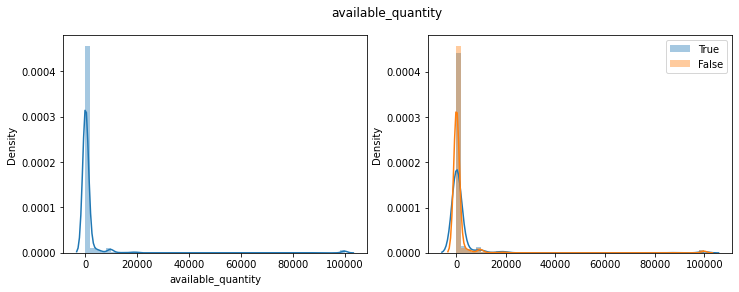

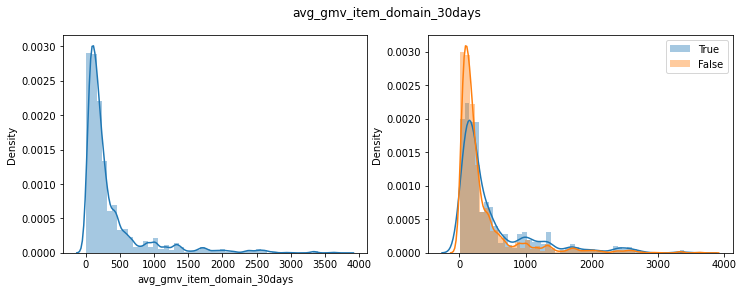

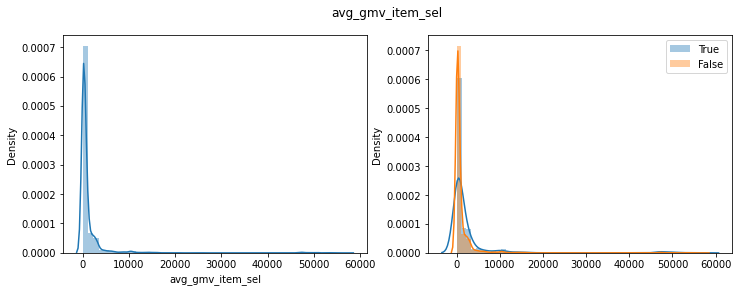

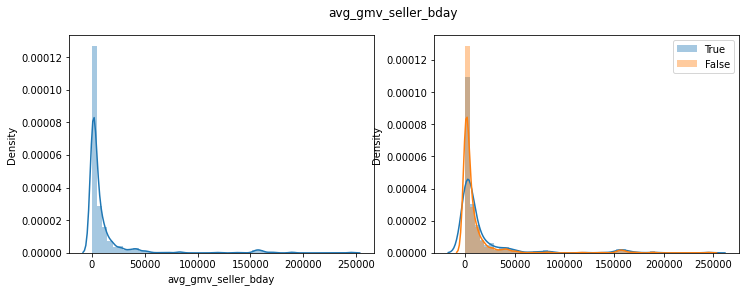

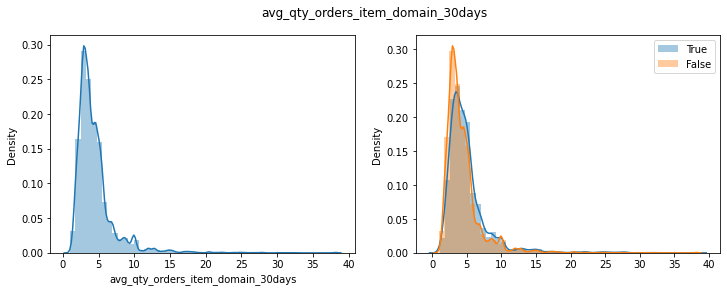

...

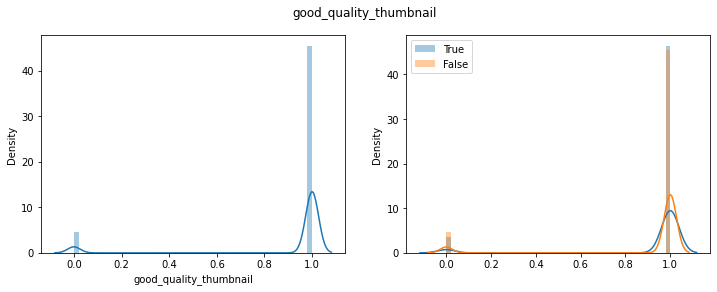

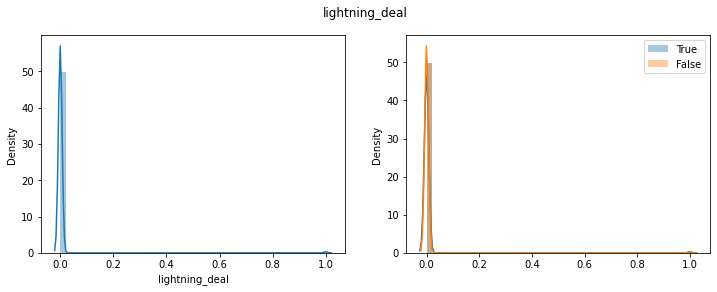

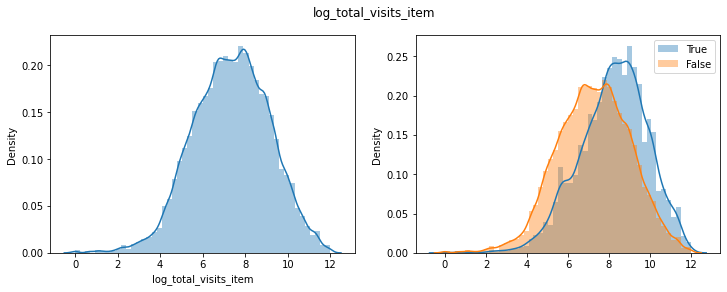

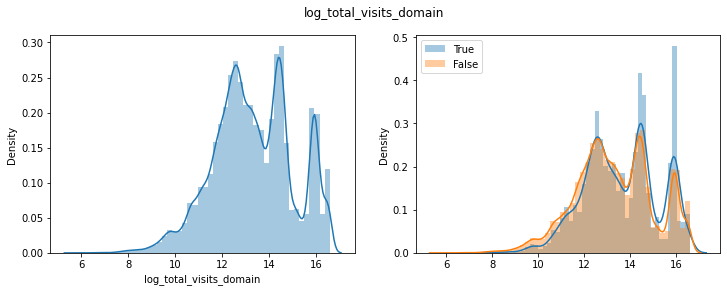

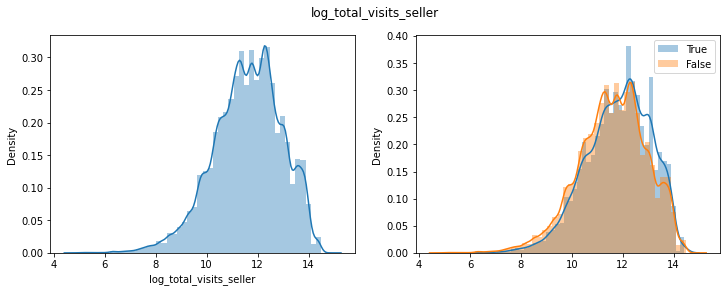

In [38]:
dropped_col = ['category_id','site_id','domain_id','item_id','print_server_timestamp','date','deal_print_id','etl_version','user_id','full_name','listing_type_id','logistic_type','main_picture','platform','tags','title','uid']
for feat in list(data_na_dropped.columns):
  if feat  not in dropped_col:
    plot_distribution(data_na_dropped, 'conversion', feat)

In [27]:
def pie_charts_conv_ful():
  conv_ful_T = 0
  conv_ful_F = 0
  conv_ful_TF = 0
  conv_ful_FT = 0
  for i in data_na_dropped.index[0:(len(data_na_dropped.index)-1)]:
    if data_na_dropped.loc[i,'conversion'] == True and data_na_dropped.loc[i, 'fulfillment'] == True:
      conv_ful_T += 1
  for i in data_na_dropped.index[0:(len(data_na_dropped.index)-1)]:
    if data_na_dropped.loc[i,'conversion'] == False and data_na_dropped.loc[i, 'fulfillment'] == False:
      conv_ful_F += 1
  for i in data_na_dropped.index[0:(len(data_na_dropped.index)-1)]:
    if data_na_dropped.loc[i, 'conversion'] == True and data_na_dropped.loc[i, 'fulfillment'] == False:
      conv_ful_TF += 1
  for i in data_na_dropped.index[0:(len(data_na_dropped.index)-1)]:
    if data_na_dropped.loc[i, 'conversion'] == False and data_na_dropped.loc[i, 'fulfillment'] == True:
      conv_ful_FT += 1
  conv_ful = [conv_ful_T, conv_ful_F, conv_ful_TF, conv_ful_FT]
  names = ['Conversion & Fulfillment = True', 'Conversion & Fulfillment = False', 'Conversion = True & Fulfillment = False', 'Conversion = False & Fulfillment = True' ]
  fig = px.pie(values=conv_ful, names=names)
  fig.show()
pie_charts_conv_ful()


In [28]:
def pie_charts_conv_free_ship():
  conv_free_ship_T = 0
  conv_free_ship_F = 0
  conv_free_ship_TF = 0
  conv_free_ship_FT = 0
  for i in data_na_dropped.index[0:(len(data_na_dropped.index)-1)]:
    if data_na_dropped.loc[i,'conversion'] == True and data_na_dropped.loc[i, 'free_shipping'] == True:
      conv_free_ship_T += 1
  for i in data_na_dropped.index[0:(len(data_na_dropped.index)-1)]:
    if data_na_dropped.loc[i,'conversion'] == False and data_na_dropped.loc[i, 'free_shipping'] == False:
      conv_free_ship_F += 1
  for i in data_na_dropped.index[0:(len(data_na_dropped.index)-1)]:
    if data_na_dropped.loc[i, 'conversion'] == True and data_na_dropped.loc[i, 'free_shipping'] == False:
      conv_free_ship_TF += 1
  for i in data_na_dropped.index[0:(len(data_na_dropped.index)-1)]:
    if data_na_dropped.loc[i, 'conversion'] == False and data_na_dropped.loc[i, 'free_shipping'] == True:
      conv_free_ship_FT += 1
  conv_free_ship = [conv_free_ship_T, conv_free_ship_F, conv_free_ship_TF, conv_free_ship_FT]
  names = ['Conversion & Free_Shipping = True', 'Conversion & Free_Shipping = False', 'Conversion = True & Free_Shipping = False', 'Conversion = False & Free_Shipping = True' ]
  fig = px.pie(values=conv_free_ship, names=names)
  fig.show()
pie_charts_conv_free_ship()


In [29]:
data_na_dropped['log_total_visits_item']=np.log(data_na_dropped['total_visits_item'])
fig = px.box(data_na_dropped, x="conversion", y="log_total_visits_item")
fig.show()

In [30]:
data_na_dropped['log_total_visits_domain']=np.log(data_na_dropped['total_visits_domain'])
fig = px.box(data_na_dropped, x="conversion", y="log_total_visits_domain")
fig.show()

In [31]:
data_na_dropped['log_total_visits_seller']=np.log(data_na_dropped['total_visits_seller'])
fig = px.box(data_na_dropped, x="conversion", y="log_total_visits_seller")
fig.show()

### Feature correlation

In [32]:
fig = plt.figure(figsize=(20,20), dpi = 480)
corr_plot = sn.heatmap(data_na_dropped.corr(), annot = True, fmt = '.2f').set_title("correlation matrix")

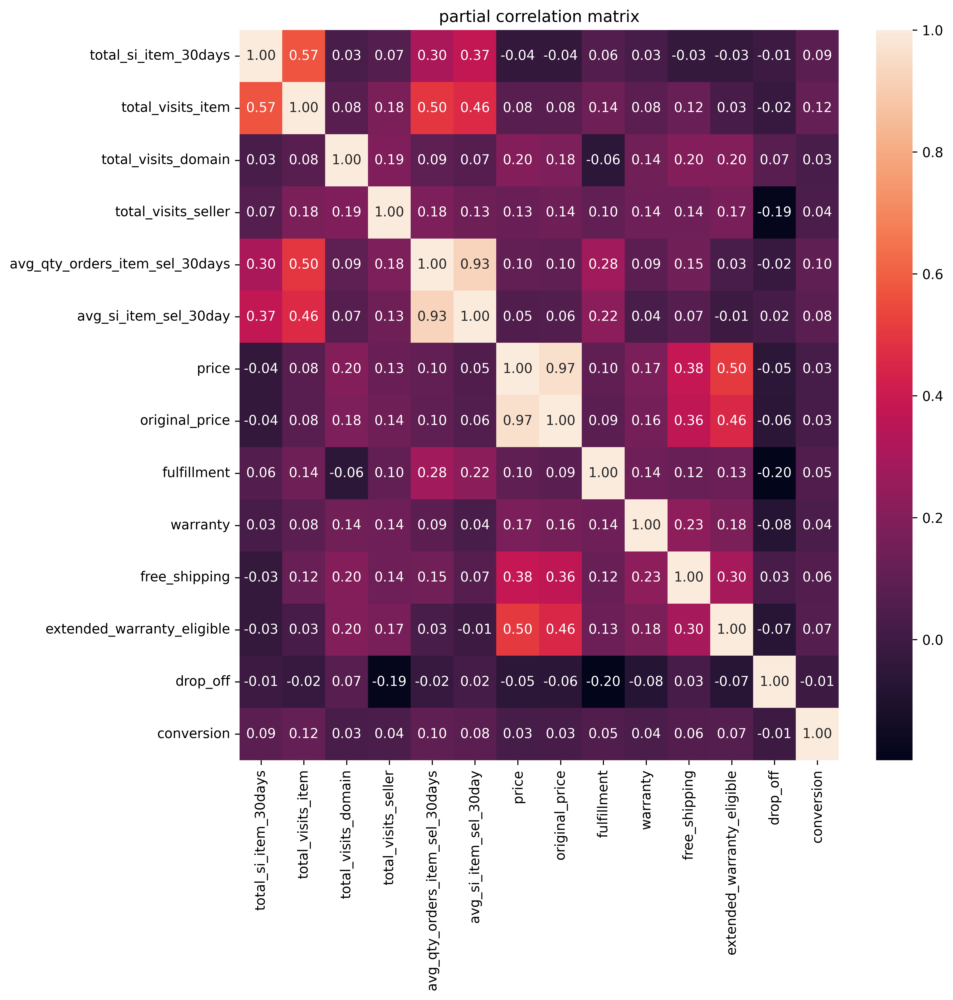

In [33]:
useful_cols = ['total_si_item_30days','total_visits_item','total_visits_domain','total_visits_seller','avg_qty_orders_item_sel_30days', 'avg_si_item_sel_30day',
               'price', 'original_price', 'fulfillment','warranty',
               'free_shipping', 'extended_warranty_eligible', 'drop_off', 'conversion']

fig = plt.figure(figsize=(10,10), dpi = 480)
# correlation matrix that contains only columns that we think could be important
corr_plot = sn.heatmap(data_na_dropped[useful_cols].corr(), annot = True, fmt = '.2f').set_title("partial correlation matrix")

### Important Feature Distributions

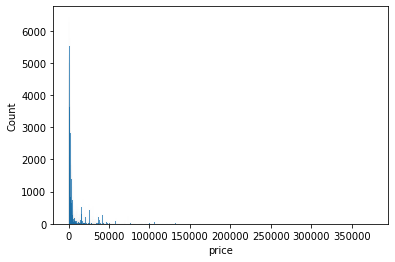

In [34]:
sn.histplot(data_na_dropped["price"])
sn.histplot(data_na_dropped["original_price"])

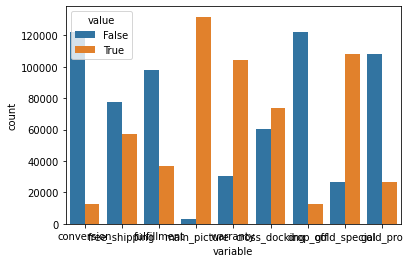

In [35]:
bool_columns = data_na_dropped[list(data_na_dropped.dtypes[data_na_dropped.dtypes == bool].index)]
sn.countplot(x="variable", hue="value", data=pd.melt(bool_columns))

Text(0.5, 1.0, 'distribution of discount')

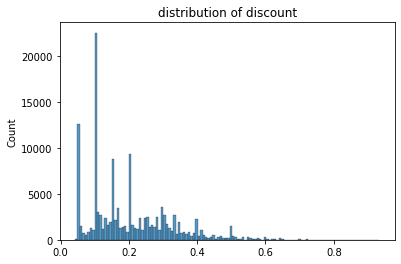

In [36]:
discount = (data_na_dropped["original_price"]-data_na_dropped["price"])/data_na_dropped["original_price"]
sn.histplot(discount).set_title("distribution of discount")